# Big Data, Programa de Ciencia de los Datos

## Proyecto Final

### Entregable #1: Investigación preiminar

* Esteban Sáenz Villalobos (**esaenz7@gmail.com**).
* Entrega: 22 de agosto 2021, 23:00.
* Valor: 5%.
* Observaciones: Trabajo elaborado desde Google Colab. Ejecutar cada celda de código de forma secuencial.

---

##Objetivo

Aplicar técnicas para extracción, transformación, carga de datos realistas de la vida cotidiana  y  generar  predicciones  a  partir  de  esos datos  depurados. 

##Descripción  general:

La realización de este proyecto busca que los estudiantes se expongan a las complejidades que implican obtener datos reales que provienen de múltiples fuentes. Se espera que realicen una investigación preliminar donde buscarán conjuntos de datos, abiertos o de su ámbito  laboral,  que  provengan  de  múltiples  fuentes. Posteriormente, deberán preprocesar e integrarlos de manera que puedan ser utilizados para  propósitos  analíticos  y  predictivos. Los  resultados  serán  presentados  en  la  clase  final del  módulo.

---

## Opción #1

* Nombre del proyecto: ***Predicción de vuelos demorados para el sector aeronáutico doméstico de los EEUU***.

* Objetivo predictivo: el proyecto tiene como objetivo general utilizar las técnicas de ETL y aprendizaje automático para poder predecir, por medio del modelado de patrones a partir de un sub-conjunto de entrenamiento, ***el estado de un vuelo en particular, siendo este clasificado de forma binaria como: "a tiempo" o "demorado"***, para lo cual se validará dicho modelo a través de un sub-conjunto de prueba cuyos resultados serán utilizados para la obtención de métricas específicas que permitan analizar su rendimiento.

* Ruta:

    a) Realizar la carga, exploración, análisis, filtrado y limpieza de datos correspondiente para cada dataset.

    b) Determinar a partir de la columna de demora en el arribo "arr_delay", el valor de tiempo que permitirá realizar la clasificación binaria entre un vuelo demorado y un vuelo a tiempo.
    
    c) Definir la columna correspondiente para dichas clases. La columna objetivo o "target" se llamará "**delayed**" y contendrá el valor booleano para las 2 clases posibles de resultados: "demorado" o "a tiempo".

    d) Relizar la unión de los datasets a partir de las columnas correspondientes según se detalla con el siguiente pseudocódigo (algunos nombres de columnas son modificados durante la fase de preparación para facilitar su uso):

      # dataframe -> merge(flights.origin == airports.iata)
      # dataframe -> merge(airports.icao == weather.airportcode 
                          & flights.date == weather.date)

  En este caso se realizará la unión de los conjuntos de datos principales de vuelos ("flights") y eventos meterológicos ("weather") por medio de un dataset intermedio con la lista de aeropuertos ("airports"), el cual posee los códigos IATA e ICAO que utilizan respectivamente los datasets principales. Además se incorpora una llave adicional entre fechas, para mantener la relación del vuelo con el evento meteorológico reportado según el día en particular.

    e) Filtrar y preparar las columnas y sub-conjuntos para el proceso de aprendizaje automático.

    f) Entrenar los modelos de clasificación seleccionados.

    g) Medir y analizar el rendimiento de cada modelo aplicado.
    
    h) Realizar los ajustes que se consideren pertinentes y repetir los pasos f y g.

* Contexto y alcance: el proyecto tiene como contexto los vuelos domésticos registrados en EEUU durante el año 2018, al cual se adjuntan los registros de eventos meteorológicos y su severidad ocurridos para cada día del año y para cada aeropuerto en particular. Ambos datasets son unidos gracias al conjunto de datos proporcionado por la lista extensa de aeropuertos del repositorio "openflights.org" el cual aporta tanto el código IATA (International Air Transport Association) utilizado coloquialmente para el manejo de vuelos comerciales, como el código oficial ICAO (International Civil Aviation Organization) utilizado para identificar las estaciones de medición meteorológica.

* Limitaciones: en cuanto a su diseño, desarrollo e implementación del modelo de aprendizaje automático, el proyecto comprende todos los requerimientos establecidos y se encuentra limitado básicamente por la capacidad computacional del equipo utilizado.

* Fuentes de datos analizadas: el proyecto está basado en los datos de 2 archivos CSV y 1 archivo DAT, provenientes de 2 fuentes distintas de dominio público.
  
  * Kaggle

    1. [Airline Delay and Cancellation Data, 2018](https://www.kaggle.com/yuanyuwendymu/airline-delay-and-cancellation-data-2009-2018?select=2018.csv) [archivo "***2018.csv***"]. La Oficina de Estadísticas de Transporte del Departamento de Transporte de los EE. UU. (DOT) rastrea el desempeño puntual de los vuelos nacionales operados por grandes compañías aéreas. La información resumida sobre el número de vuelos puntuales, retrasados, cancelados y desviados se publica en este conjunto de datos de vuelos de 2018.
    2. [US Weather Events (2018)](https://www.kaggle.com/sobhanmoosavi/us-weather-events) [archivo "***WeatherEvents_Jan2016-Dec2020.csv***"].Se trata de un conjunto de datos de eventos meteorológicos de todo EEUU que incluye 6,3 millones de eventos y cubre 49 estados. Los datos se recopilan desde enero de 2016 hasta diciembre de 2020, utilizando informes meteorológicos históricos que se recopilaron de 2,071 estaciones meteorológicas en aeropuertos en todo el país.

  * Openflights

    1. [Open data downloads](https://openflights.org/data.html) [archivo "***airports.dat***"]. La base de datos de aeropuertos de OpenFlights contiene más de 10,000 aeropuertos, estaciones de tren y terminales de ferry en todo el mundo.

* Descripción detallada: a continuación se procede a realizar un análisis descriptivo de los datos por medio de códificación y visualizaciones.

--- 

### Glosario

	fl_date: fecha del vuelo.
    op_carrier: identificador de la aerolínea.
    origin: código de aeropuerto de salida.
    dest: código del aeropuerto de destino.
    crs_dep_time: hora de salida planificada.
    dep_time: hora real de salida.
    dep_delay: retraso total a la salida en minutos.
    taxi_out: el tiempo transcurrido entre la salida de la puerta del aeropuerto de origen y el apagado de las ruedas.
    wheels_off: el momento en el que las ruedas de la aeronave abandonan el suelo.
    wheels_on: el momento en el que las ruedas de la aeronave tocan el suelo.
    taxi_in: la duración del tiempo transcurrido entre la puesta en marcha y la llegada a la puerta del aeropuerto de destino.
    crs_arr_time: hora prevista de llegada.
    arr_time: hora de llegada real = hora de llegada - llegada_programada.
    arr_delay: retraso total a la llegada en minutos.
    cancelled: vuelo cancelado (1 = cancelado).
    diverted: aeronave aterrizó en un aeropuerto diferente al programado.
    crs_elapsed_time: cantidad de tiempo planificada necesaria para el viaje de vuelo.
    actual_elapsed_time: tiempo_aire + taxi_in + taxi_out.
    air_time: la duración de tiempo entre wheels_off y wheels_on time.
    distance: distancia entre dos aeropuertos.
    severe-cold: el caso de tener una temperatura extremadamente baja, con temperatura por debajo de los -23,7 grados centígrados.
    fog: el caso en el que hay una condición de baja visibilidad como resultado de la niebla o neblina.
    hail: el caso de tener precipitaciones sólidas que incluyen gránulos de hielo y granizo.
    rain: el caso de tener lluvia, que va de ligera a fuerte.
    snow: el caso de tener nieve, que va de ligera a fuerte.
    storm: la condición de mucho viento, donde la velocidad del viento es de al menos 60 km / h.
    other precipitation: cualquier otro tipo de precipitación que no pueda asignarse a los tipos de eventos descritos anteriormente.
    iata: código IATA de 3 letras, si está disponible.
    icao: código ICAO de 4 letras, si está disponible.

---

### Carga de modúlos, librerías y configuraciones necesarias

In [1]:
#módulos y configuraciones necesarias

import sys, os, io, pathlib, datetime as dt, re, math, random, torch, numpy as np, pandas as pd, matplotlib as matp, scipy as sci, seaborn as sns, IPython.display as ipdisp
from sklearn import preprocessing as skl_prep, linear_model as skl_linmode, metrics as skl_metrics, decomposition as skl_decomp, neighbors as skl_neighbors, naive_bayes as skl_nbayes
from matplotlib import pyplot as plt
from ipywidgets import widgets

ipdisp.set_matplotlib_formats('pdf', 'svg')
np.set_printoptions(precision=6, suppress=True, linewidth=160)
torch.set_printoptions(precision=6, sci_mode=None, linewidth=160)
np.seterr(divide = 'ignore', invalid = 'ignore')
pd.set_option('mode.chained_assignment', None, 'display.width', 160, 'display.max_colwidth', 160, 'display.max_rows', 100, 'display.max_columns', None, 'display.max_info_rows', 50, 'display.max_info_columns', 50)
# plt.style.available
matp.style.use('seaborn')

In [2]:
%%capture
#extensiones varias para jupyter y api's para acceso a repositorios (kaggle, google drive)

# %reload_ext autoreload
# %autoreload 2
# !jupyter nbextension enable
# !pip install https://github.com/ipython-contrib/jupyter_contrib_nbextensions/tarball/master
# !pip install jupyter_nbextensions_configurator
# !jupyter contrib nbextension install --user
# !jupyter nbextensions_configurator enable --user
# !conda install -c damianavila82 rise
!"{sys.executable}" -m pip install -U pandas-profiling
!jupyter nbextension enable --py widgetsnbextension

def apikaggle():
  """
  Función para el uso del API de Kaggle
  """
  try:
    from googleapiclient.discovery import build
    import io, os
    from googleapiclient.http import MediaIoBaseDownload
    from google.colab import auth
    auth.authenticate_user()
    drive_service = build('drive', 'v3')
    results = drive_service.files().list(
            q="name = 'kaggle.json'", fields="files(id)").execute()
    kaggle_api_key = results.get('files', [])
    filename = "/root/.kaggle/kaggle.json"  # NOTE: This is different from the Medium post!
    os.makedirs(os.path.dirname(filename), exist_ok=True)
    request = drive_service.files().get_media(fileId=kaggle_api_key[0]['id'])
    fh = io.FileIO(filename, 'wb')
    downloader = MediaIoBaseDownload(fh, request)
    done = False
    while done is False:
        status, done = downloader.next_chunk()
        print("Download %d%%." % int(status.progress() * 100))
    os.chmod(filename, 600)
    return True
  except Exception as e:
    exc_type, exc_obj, exc_tb = sys.exc_info()
    print(exc_type, os.path.split(exc_tb.tb_frame.f_code.co_filename)[1], exc_tb.tb_lineno, exc_obj)

#descarga de datasets usando api de Kaggle
!pip install -q kaggle
# apikaggle()
# !kaggle datasets download -d yuanyuwendymu/airline-delay-and-cancellation-data-2009-2018
# !unzip airline-delay-and-cancellation-data-2009-2018.zip
# !kaggle datasets download -d sobhanmoosavi/us-weather-events
# !unzip us-weather-events.zip
# !kaggle datasets download -d aravindram11/list-of-us-airports
# !unzip list-of-us-airports.zip
# !kaggle datasets download -d volpatto/coffee-quality-database-from-cqi
# !unzip coffee-quality-database-from-cqi.zip
# !kaggle datasets download -d sevgisarac/temperature-change
# !unzip temperature-change.zip

#descarga de datasets usando api de Google Drive
!pip install -q gdown
!gdown https://drive.google.com/uc?id=1c1nSkkEzzBqpcuxuZ3YnasmKT4GyMvOl
!gdown https://drive.google.com/uc?id=1gZTAbAtd1dePC-EDoruxp9uJUXsCAM58
!gdown https://drive.google.com/uc?id=14nu8FTLohAgZ17agET1DFRNccJN2LmFg
!gdown https://drive.google.com/uc?id=1OaR5dy8Nt6J3365nIw0VwOEviDMW6P_h
!gdown https://drive.google.com/uc?id=1cR9o_jVY5rWqpmMIL3CSCX3YomNdRJgr
!gdown https://drive.google.com/uc?id=1ggGsqCIjAEsBj5kzXlz_KW3wj44H4ggW

In [3]:
#funciones varias para manejo de datos

def dfsnap(df, fn=lambda x: x.shape, print=True):
  display(fn(df)) if print else fn(df)
  return df

def dfsetcol(df, fn=lambda x: x.columns.map('_'.join), cols=None):
  df.columns = cols if cols else fn(df)
  return df

def dffilter(df, fn, axis="rows"):
  if axis == "rows": return df[fn(df)]
  elif axis == "columns": return df.iloc[:, fn(df)]

### Carga de datos

In [4]:
#lectura de los archicos csv por medio de la librería pandas

flights = pd.read_csv('2018.csv')
weather = pd.read_csv('WeatherEvents_Jan2016-Dec2020.csv')
airports = pd.read_csv('airports.dat', header=None)

### Consulta y exploración de datos

In [5]:
#despliegue de la información (incluyendo conteo de valores nulos) para cada dataset

print('\nDataset "flights"')
display(flights.info(null_counts=True), flights.head(3).append(flights.tail(3)))
print('\nDataset "weather"')
display(weather.info(null_counts=True), weather.head(3).append(weather.tail(3)))
print('\nDataset "airports"')
display(airports.info(null_counts=True), airports.head(3).append(airports.tail(3)))


Dataset "flights"
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7213446 entries, 0 to 7213445
Data columns (total 28 columns):
 #   Column               Non-Null Count    Dtype  
---  ------               --------------    -----  
 0   FL_DATE              7213446 non-null  object 
 1   OP_CARRIER           7213446 non-null  object 
 2   OP_CARRIER_FL_NUM    7213446 non-null  int64  
 3   ORIGIN               7213446 non-null  object 
 4   DEST                 7213446 non-null  object 
 5   CRS_DEP_TIME         7213446 non-null  int64  
 6   DEP_TIME             7101129 non-null  float64
 7   DEP_DELAY            7096212 non-null  float64
 8   TAXI_OUT             7097616 non-null  float64
 9   WHEELS_OFF           7097617 non-null  float64
 10  WHEELS_ON            7094200 non-null  float64
 11  TAXI_IN              7094200 non-null  float64
 12  CRS_ARR_TIME         7213446 non-null  int64  
 13  ARR_TIME             7094201 non-null  float64
 14  ARR_DELAY            7076406 no

None

,FL_DATE,OP_CARRIER,OP_CARRIER_FL_NUM,ORIGIN,DEST,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,CANCELLED,CANCELLATION_CODE,DIVERTED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,DISTANCE,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,Unnamed: 27
0,2018-01-01,UA,2429,EWR,DEN,1517,1512.0,-5.0,15.0,1527.0,1712.0,10.0,1745,1722.0,-23.0,0.0,NaN,0.0,268.0,250.0,225.0,1605.0,NaN,NaN,NaN,NaN,NaN,NaN
1,2018-01-01,UA,2427,LAS,SFO,1115,1107.0,-8.0,11.0,1118.0,1223.0,7.0,1254,1230.0,-24.0,0.0,NaN,0.0,99.0,83.0,65.0,414.0,NaN,NaN,NaN,NaN,NaN,NaN
2,2018-01-01,UA,2426,SNA,DEN,1335,1330.0,-5.0,15.0,1345.0,1631.0,5.0,1649,1636.0,-13.0,0.0,NaN,0.0,134.0,126.0,106.0,846.0,NaN,NaN,NaN,NaN,NaN,NaN
7213443,2018-12-31,AA,1817,CLT,MEM,2015,2010.0,-5.0,36.0,2046.0,2114.0,4.0,2107,2118.0,11.0,0.0,NaN,0.0,112.0,128.0,88.0,511.0,NaN,NaN,NaN,NaN,NaN,NaN
7213444,2018-12-31,AA,1818,CLT,RDU,1300,1323.0,23.0,11.0,1334.0,1400.0,4.0,1350,1404.0,14.0,0.0,NaN,0.0,50.0,41.0,26.0,130.0,NaN,NaN,NaN,NaN,NaN,NaN
7213445,2018-12-31,AA,1818,RDU,CLT,1435,1443.0,8.0,8.0,1451.0,1535.0,7.0,1546,1542.0,-4.0,0.0,NaN,0.0,71.0,59.0,44.0,130.0,NaN,NaN,NaN,NaN,NaN,NaN



Dataset "weather"
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6274206 entries, 0 to 6274205
Data columns (total 13 columns):
 #   Column          Non-Null Count    Dtype  
---  ------          --------------    -----  
 0   EventId         6274206 non-null  object 
 1   Type            6274206 non-null  object 
 2   Severity        6274206 non-null  object 
 3   StartTime(UTC)  6274206 non-null  object 
 4   EndTime(UTC)    6274206 non-null  object 
 5   TimeZone        6274206 non-null  object 
 6   AirportCode     6274206 non-null  object 
 7   LocationLat     6274206 non-null  float64
 8   LocationLng     6274206 non-null  float64
 9   City            6262523 non-null  object 
 10  County          6274206 non-null  object 
 11  State           6274206 non-null  object 
 12  ZipCode         6225569 non-null  float64
dtypes: float64(3), object(10)
memory usage: 622.3+ MB


None

,EventId,Type,Severity,StartTime(UTC),EndTime(UTC),TimeZone,AirportCode,LocationLat,LocationLng,City,County,State,ZipCode
0,W-1,Snow,Light,2016-01-06 23:14:00,2016-01-07 00:34:00,US/Mountain,K04V,38.0972,-106.1689,Saguache,Saguache,CO,81149.0
1,W-2,Snow,Light,2016-01-07 04:14:00,2016-01-07 04:54:00,US/Mountain,K04V,38.0972,-106.1689,Saguache,Saguache,CO,81149.0
2,W-3,Snow,Light,2016-01-07 05:54:00,2016-01-07 15:34:00,US/Mountain,K04V,38.0972,-106.1689,Saguache,Saguache,CO,81149.0
6274203,W-6276146,Snow,Light,2020-12-15 03:19:00,2020-12-15 05:53:00,US/Mountain,KBVR,42.5833,-108.2833,Lander,Fremont,WY,82520.0
6274204,W-6276147,Snow,Light,2020-12-23 04:24:00,2020-12-23 05:53:00,US/Mountain,KBVR,42.5833,-108.2833,Lander,Fremont,WY,82520.0
6274205,W-6276148,Snow,Light,2020-12-23 10:53:00,2020-12-23 11:26:00,US/Mountain,KBVR,42.5833,-108.2833,Lander,Fremont,WY,82520.0



Dataset "airports"
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7698 entries, 0 to 7697
Data columns (total 14 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       7698 non-null   int64  
 1   1       7698 non-null   object 
 2   2       7649 non-null   object 
 3   3       7698 non-null   object 
 4   4       7698 non-null   object 
 5   5       7698 non-null   object 
 6   6       7698 non-null   float64
 7   7       7698 non-null   float64
 8   8       7698 non-null   int64  
 9   9       7698 non-null   object 
 10  10      7698 non-null   object 
 11  11      7698 non-null   object 
 12  12      7698 non-null   object 
 13  13      7698 non-null   object 
dtypes: float64(2), int64(2), object(10)
memory usage: 842.1+ KB


None

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,1,Goroka Airport,Goroka,Papua New Guinea,GKA,AYGA,-6.081690,145.391998,5282,10,U,Pacific/Port_Moresby,airport,OurAirports
1,2,Madang Airport,Madang,Papua New Guinea,MAG,AYMD,-5.207080,145.789001,20,10,U,Pacific/Port_Moresby,airport,OurAirports
2,3,Mount Hagen Kagamuga Airport,Mount Hagen,Papua New Guinea,HGU,AYMH,-5.826790,144.296005,5388,10,U,Pacific/Port_Moresby,airport,OurAirports
7695,14108,Krechevitsy Air Base,Novgorod,Russia,\N,ULLK,58.625000,31.385000,85,\N,\N,\N,airport,OurAirports
7696,14109,Desierto de Atacama Airport,Copiapo,Chile,CPO,SCAT,-27.261200,-70.779198,670,\N,\N,\N,airport,OurAirports
7697,14110,Melitopol Air Base,Melitopol,Ukraine,\N,UKDM,46.880001,35.305000,0,\N,\N,\N,airport,OurAirports


  * Se puede observar que el dataset Flights cuenta con alrededor de 7 millones de registros, Weather cuenta con poco más de 6 millones y Airports con casi 8 mil.

  * Esto nos indica que al momento de unir los datos y tomando en cuenta que existen días en donde pueden ocurrir 0 o más eventos meteorológicos para el año y país seleccionado (2018, EEUU), se podría llegar a obtener un conjunto final del orden de varios millones de observaciones.

  * El conjunto Airports se limita a la lista de aeropuertos que pertenecen tanto al conjunto Flights como al conjunto Weather para EEUU en el año 2018, por lo que su extensión se encuentra limitada a esta ventana.

  * Existen columnas de variables que pueden ser excluidas desde el inicio del proceso debido a diferentes razones como la proporción de valores nulos, su redundancia o la poca utilidad que tienen sus valores dentro del objeto de estudio. Ejemplo de ello están: en Airports las columnas de latitud, longitud, región, tipo, entre otras; en Weather las columnas de id, zona horaria, longitud, latitud, condado, estado, código postal, entre otras; en Flights las columnas de razones de demora, número de vuelo, entre otras.

---

### Selección de datos

In [6]:
#pipelines para tratamiento de datos

df1a = flights.copy()
df1a = (df1a.pipe(dfsnap)
.pipe(dfsetcol, fn=lambda x: x.columns.str.lower()
.str.strip().str.replace(" ", "_"))
.filter(items=['fl_date','op_carrier','origin','dest','crs_dep_time','dep_delay','taxi_out','wheels_off','wheels_on','taxi_in','crs_arr_time','arr_delay',\
               'cancelled','diverted','crs_elapsed_time','actual_elapsed_time','air_time','distance'],axis=1)
.assign(fl_date = pd.to_datetime(df1a['fl_date'], format='%Y-%m-%d'))
.pipe(dfsnap)
)

df2a = weather.copy()
df2a = (df2a.pipe(dfsnap)
.pipe(dfsetcol, fn=lambda x: x.columns.str.lower()
.str.strip().str.replace(" ", "_")
.str.strip().str.replace("[()]", ""))
.filter(items=['airportcode','city','starttimeutc','endtimeutc','type', 'severity'],axis=1)
.assign(starttimeutc = pd.to_datetime(df2a['starttimeutc'], format='%Y-%m-%d'))
.assign(endtimeutc = pd.to_datetime(df2a['endtimeutc'], format='%Y-%m-%d'))
.pipe(dfsnap)
)

df3a = airports.copy()
df3a = (df3a.pipe(dfsnap)
.filter(items=[1,2,3,4,5],axis=1)
.pipe(dfsetcol, cols=['airport','city','country','iata','icao'])
.query('country == "United States"')
.pipe(dfsnap)
)

(7213446, 28)

(7213446, 18)

(6274206, 13)

(6274206, 6)

(7698, 14)

(1512, 5)

  * Por medio de pipelines de transformación se seleccionan, filtran y renombran las columnas de variables que formarán parte de la etapa de análisis y visualización preliminar de datos.
  
  * Los datos impresos en consola indican el shape de cada dataset antes y después de su pipeline.

---

### Visualización **preliminar** de datos

In [7]:
#análisis de datos

#proporción de valores nulos
sf1, sf2, ef = '\n\033[1m\033[106m\033[30m', '\n\033[1m\033[103m\033[30m', '\033[0m'
nulltab = lambda x: round(x.isna().sum()*100/x.shape[0], 2)
print(sf1, 'Porcentaje de valores nulos por cada conjunto de datos y columna.', ef)
list(map(lambda x: print('\nColumna\t\tNulos(%)', nulltab(x), sep='\n'), [df1a, df2a, df3a]))

#distribución de datos (conteo de valores únicos)
uniquelist = lambda x: round(x.value_counts(normalize=True, sort=True, ascending=False)*100, 2)
print(sf1, 'Distribución porcentual de valores categóricos para las columnas más importantes de cada conjunto de datos.', ef)
list(map(lambda x: print(sf2, 'Flights', x.name, ef, uniquelist(x), sep='\n'), [df1a['op_carrier'], df1a['origin'], df1a['dest']]))
list(map(lambda x: print(sf2, 'Weather', x.name, ef, uniquelist(x), sep='\n'), [df2a['airportcode'], df2a['city'], df2a['type'], df2a['severity']]))
list(map(lambda x: print(sf2, 'Airports', x.name, ef, uniquelist(x), sep='\n'), [df3a['city'], df3a['iata'], df3a['icao']]))


 Porcentaje de valores nulos por cada conjunto de datos y columna. 

Columna		Nulos(%)
fl_date                0.00
op_carrier             0.00
origin                 0.00
dest                   0.00
crs_dep_time           0.00
dep_delay              1.63
taxi_out               1.61
wheels_off             1.61
wheels_on              1.65
taxi_in                1.65
crs_arr_time           0.00
arr_delay              1.90
cancelled              0.00
diverted               0.00
crs_elapsed_time       0.00
actual_elapsed_time    1.86
air_time               1.86
distance               0.00
dtype: float64

Columna		Nulos(%)
airportcode     0.00
city            0.19
starttimeutc    0.00
endtimeutc      0.00
type            0.00
severity        0.00
dtype: float64

Columna		Nulos(%)
airport    0.0
city       0.0
country    0.0
iata       0.0
icao       0.0
dtype: float64

 Distribución porcentual de valores categóricos para las columnas más importantes de cada conjunto de datos. 


Flights
op_

[None, None, None]

  * Para las variables seleccionadas, se puede observar que en cada dataset la proporción de valores nulos es baja (hasta un máximo del 2% aprox. para los casos más relevantes), por lo que se puede optar por su eliminación como método de imputación.

  * En cuanto a la proporción de valores categóricos en las columnas respectivas, es evidente que algunas variables como las aerolíneas agrupan la mayor cantidad de observaciones en un grupo de clases reducido, debido a la popularidad, cobertura y tamaño de algunas compañías. Lo mismo sucede con los aeropuertos más grandes y concurridos que funcionan incluso como aeropuertos internacionales. En cuando a los eventos meteorológicos, las lluvias predominan la variable de tipo de evento con aprox. un 60% y respecto a la variable de severidad, la condición leve abarca la mayoría de las observaciones registradas con una proporción similar. Ambos comportamientos son en principio normales y esperados para un conjunto de datos representativo y de un tamaño n en el orden de los millones de registros.
  
  * Para la columna de fecha, se realizará la categorización como día de la semana y semana del año, tratando de buscar alguna tendencia interesante que aporte valor al objetivo final de predicción.

---

Momentos estadísticos de la variable "arr_delay" y "dep_delay" (tiempo en minutos).
Arrival delay
count    7.076406e+06
mean     5.048581e+00
std      4.692664e+01
min     -1.200000e+02
25%     -1.400000e+01
50%     -6.000000e+00
75%      8.000000e+00
max      2.692000e+03
Name: arr_delay, dtype: float64
Departure delay
count    7.096212e+06
mean     9.969858e+00
std      4.482964e+01
min     -1.220000e+02
25%     -5.000000e+00
50%     -2.000000e+00
75%      7.000000e+00
max      2.710000e+03
Name: dep_delay, dtype: float64


Visualización de la relación entre las clases de la columna objetivo.


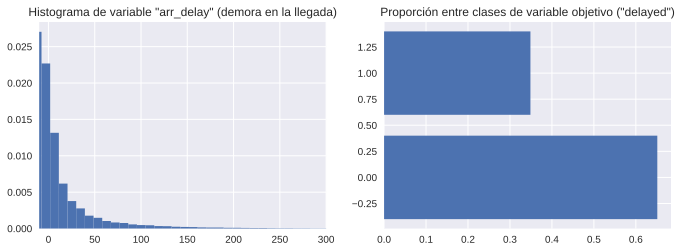

Relación entre tiempos de demora en la salida y la llegada por aerolínea.


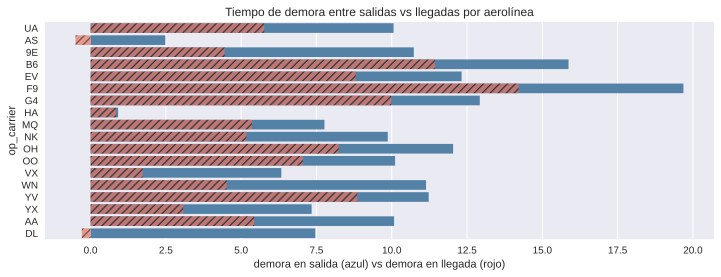

Visualización de la tendencia de vuelos demorados.


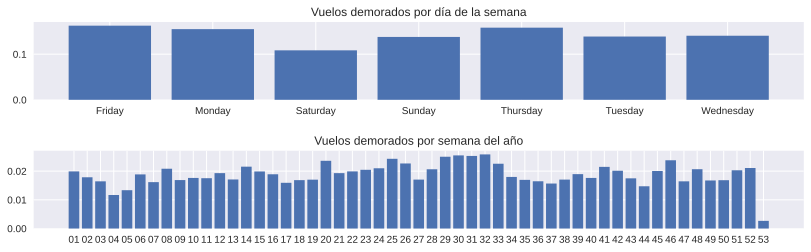

Gráfico de parcela para visualización de correlación entre variables seleccionadas.


In [8]:
#análisis de datos

#se crea la columna objetivo "delayed" con valores binarios según corresponda: "a tiempo" (arr_delay) <= 0 > (arr_delay) "vuelo demorado"
df1a['delayed'] = df1a['arr_delay'].apply(lambda x: 1 if x > 0 else 0)
#se crean las columnas para las variables de día de la semana y semana del año, para su análisis respectivo
df1a['day'] = df1a['fl_date'].dt.strftime('%A')
df1a['week'] = df1a['fl_date'].dt.strftime('%W')

print('Momentos estadísticos de la variable "arr_delay" y "dep_delay" (tiempo en minutos).')
print('Arrival delay', df1a['arr_delay'].describe(), 'Departure delay', df1a['dep_delay'].describe(), '\n', sep='\n')

print('Visualización de la relación entre las clases de la columna objetivo.')
fig, ax = plt.subplots(1, 2, figsize=(10,4))
fig.tight_layout(pad=3.0)
ax[0].set_xlim(xmin=-10, xmax = 300)
ax[0].hist(df1a['arr_delay'], bins=300, density=True)
ax[1].barh(df1a['delayed'].value_counts(normalize=True).index, df1a['delayed'].value_counts(normalize=True).values)
ax[0].set(title='Histograma de variable "arr_delay" (demora en la llegada)')
ax[1].set(title='Proporción entre clases de variable objetivo ("delayed")')
plt.show()

print('Relación entre tiempos de demora en la salida y la llegada por aerolínea.')
fig, ax = plt.subplots(1, 1, figsize=(12,4))
sns.barplot(x='dep_delay', y='op_carrier', data=df1a, ax=ax, color='steelblue', ci=None)
sns.barplot(x='arr_delay', y='op_carrier', data=df1a, ax=ax, color='tomato', hatch='///', alpha=0.7,  ci=None)
ax.set(title='Tiempo de demora entre salidas vs llegadas por aerolínea', xlabel='demora en salida (azul) vs demora en llegada (rojo)')
plt.show()

print('Visualización de la tendencia de vuelos demorados.')
fig, ax = plt.subplots(2, 1, figsize=(12,4))
fig.tight_layout(pad=3.0)
ax[0].bar(df1a['day'][df1a['delayed']==1].value_counts(normalize=True).sort_index().index, df1a['day'][df1a['delayed']==1].value_counts(normalize=True).sort_index().values)
ax[1].bar(df1a['week'][df1a['delayed']==1].value_counts(normalize=True).sort_index().index, df1a['week'][df1a['delayed']==1].value_counts(normalize=True).sort_index().values)
ax[0].set(title='Vuelos demorados por día de la semana')
ax[1].set(title='Vuelos demorados por semana del año')
plt.show()

print('Gráfico de parcela para visualización de correlación entre variables seleccionadas.')
#debido a la capacidad computacional limitada, se realizará el reporte a partir un muestreo aleatorio (rs) de tamaño sample_n (10% de las observaciones)
sample = lambda x,y: x.sample(n=int(x.shape[0] * y), random_state=999)
sns.pairplot(sample(df1a[['dep_delay','taxi_out','wheels_off','arr_delay','wheels_on','taxi_in','air_time','distance']], 0.001),\
             corner=True, diag_kind='hist', height=1.5, aspect=1)
plt.show()

  * La variable objetivo o target, "delayed", es creada a partir de una función que califica cada vuelo registrado como demorado si su tiempo de llegada 'arr_delay' es mayor a cero. Se utiliza el valor de llegada y no el de salida, debido a que muchos vuelos logran reponer el tiempo perdido durante la marcha, logrando incluso en algunos casos sobreponer la demora arribando antes de lo esperado según el itinerario. Esto se evidencia en el gráfico "Relación entre tiempos de demora en la salida y la llegada por aerolínea".

  * Como se aprecia en el gráfico de la variable objetivo "delayed", la proporción es aprox. 65/35, entre vuelos a tiempo y vuelos demorados, demostrando un desbalance entre las clases del target. Dado esto, se propone hacer un undersampling para lograr un equilibrio de clases haciendo un submuestreo aleatorio de la clase mayoritaria hasta alcanzar una proporción similar entre ambas. Dado que se cuenta con una muestra lo suficientemente grande, esta técnica permitirá también disminuir el total de observaciones y con esto también la cantidad de cómputo/tiempo necesario para el resto del procesamiento.
  * Para poder comprender si la fecha de cada vuelo, en cuanto al día de la semana o la semana del año, podrían aportar valor al modelo, se crean las columnas respectivas y se grafica su tendencia.

  * La visualización de la cantidad de vuelos demorados, según el día de la semana, no demuestra alguna tendencia de relevancia que en principio permita aportar valor al modelo de predicción por implementar. En cuanto a la semana del año, se puede observar una estacionalidad representada por leves subidas y bajadas periódicas en la cantidad de vuelos demorados a lo largo del año, lo cual eventualmente podría aportar valor al modelo.

  * El gráfico de correlación permite observar en su diagonal el histograma respectivo para cada variable numérica, el cual en su mayoría asemeja al de una función de distribución exponencial, común en casos en donde se mide la ocurrencia de eventos en el tiempo. También se pueden observar algunas correlaciones positivas altas, principalmente entre las variables de distancia y tiempo de vuelo, algo a tener en consideración durante la fase de ingeniería de características para la reducción de dimensionalidad.

---

In [9]:
%%capture
#visualización de datos a través de la librería pandas_profiling

from pandas_profiling import ProfileReport
from pandas_profiling.utils.cache import cache_file

#debido a la capacidad computacional limitada, se realizará el reporte a partir un muestreo aleatorio (rs) de tamaño sample_n (10% de las observaciones)
sample = lambda x,y: x.sample(n=int(x.shape[0] * y), random_state=999)
df1aprof = ProfileReport(sample(df1a, 0.1), title="Flights", html={"style": {"full_width": True}}, sort=None)
df2aprof = ProfileReport(sample(df2a, 0.1), title="Weather", html={"style": {"full_width": True}}, sort=None)
df3aprof = ProfileReport(sample(df3a, 1), title="Airports", html={"style": {"full_width": True}}, sort=None)

df1aprof.to_file("/content/Flights.html")
df2aprof.to_file("/content/Weather.html")
df3aprof.to_file("/content/Airports.html")

### Conclusiones

Según el análisis realizado se puede concluir lo siguiente:

  * Los conjuntos de datos analizados aportan una muestra lo suficientemente grande y relevante para el aprendizaje, permitiendo inclusive, realizar un undersampling para equilibrar la proporción de clases de la variable objetivo.

  *  La gran cantidad de datos implicados en el proceso requerirán de un recurso de cómputo y/o tiempo de procesamiento considerable.

  * Los datos anexos a este cuaderno y generados mediante la librería Pandas Profiling, permiten realizar un análisis de variables mucho más exhaustivo para cada uno de los conjuntos de datos.

---

## Opción #2

* Nombre del proyecto: ***Predicción de clasificación como ganadores de taza de la excelencia, para muestras de granos de café especies arábica y robusta, de productores a nivel internacional***.

* Objetivo predictivo: el proyecto tiene como objetivo general utilizar las técnicas de ETL y aprendizaje automático para poder predecir, por medio del modelado de patrones a partir de un sub-conjunto de entrenamiento, ***la clasificación como ganadores de taza de la excelencia para muestras de cafe a nivel internacional***, para lo cual se validará dicho modelo a través de un sub-conjunto de prueba cuyos resultados serán utilizados para la obtención de métricas específicas que permitan analizar su rendimiento.

* Ruta:

    a) Realizar la carga, exploración, análisis, filtrado y limpieza de datos correspondiente para cada dataset.

    b) Determinar el valor de evaluación que permitirá realizar la clasificación binaria de ganador de taza de la excelencia a partir de los datos de la columna "total.cup.points".
    
    c) Definir la columna correspondiente a dichas clases objetivo. La columna se llamará "**coe_winner**" y contendrá el valor booleano para las 2 clases posibles de resultados: "clasificado" o "no clasificado".

    d) Relizar la unión de los datasets a partir de las columnas correspondientes según se detalla con el siguiente pseudocódigo (algunos nombres de columnas son modificados durante la fase de preparación para facilitar su uso):

      # coffea = concat([arabica, robusta])
      # climate -> new_column(year = [climate.y2012, climate.y..., climate.y2016])
      # dataframe = merge(coffea.harvest.year == climate.year)

    Los conjuntos de datos "arabica" y "robusta" serán concatenados pues cada uno contiene las mismas columnas de variables, siendo la columna "species" la que representa justamente el tipo de especie a la que corresponde cada uno de los datasets. Por otra parte, el conjunto resultante se unirá a "climate" por medio de la columna de año, permitiendo relacionar el cambio de temperatura de un año en particular con la cosecha del grano en ese mismo año y las demás características correspondientes. Para el dataset "climate" cada año se representa en columnas independientes por lo que deben ser trasladadas como valores de filas dentro una nueva columna de año.

    e) Filtrar y preparar las columnas y sub-conjuntos para el proceso de aprendizaje automático.

    f) Entrenar los modelos de clasificación seleccionados.

    g) Medir y analizar el rendimiento de cada modelo aplicado.
    
    h) Realizar los ajustes que se consideren pertinentes y repetir los pasos f y g.

* Contexto y alcance: el proyecto tiene como contexto las muestras de granos de café presentadas, analizadas y calificadas durante los años 2012 a 2016, junto con la característica independiente de variación mensual de temperatura registrada y promediada para cada región y año de cosecha en particular.

* Limitaciones: el proyecto en cuanto a su diseño, desarrollo e implementación del modelo de aprendizaje automático están limitados a los requerimientos establecidos por el programa del curso y a la capacidad computacional del equipo utilizado.

* Fuentes de datos analizadas: el proyecto está basado en los datos de 3 archivos CSV provenientes de 2 fuentes distintas de dominio público.
  
  * Kaggle

    1. [Coffee Quality database from CQI Coffee Quality Institute](https://www.kaggle.com/volpatto/coffee-quality-database-from-cqi) [archivos "***arabica.csv***", "***robusta.csv***"]. Estos datos contienen revisiones de granos de café arábica y robusta de revisores capacitados del Coffee Quality Institute. Dentro de las características se incluyen: aroma, sabor, regusto, acidez, dulzura, cuerpo, equilibrio, uniformidad, limpieza de la taza, humedad, defectos, además de datos sobre el grano como: método de procesamiento, color, especie y datos sobre el productor como: país de origen, región, finca, compañía, año de cosecha, altitud.
    2. [Temperature change](https://www.kaggle.com/sevgisarac/temperature-change) [archivo "***Environment_Temperature_change_E_All_Data_NOFLAG.csv***"]. La FAOSTAT difunde estadísticas del cambio de temperatura superficial media por país, con actualizaciones anuales. 

* Descripción detallada: a continuación se procede a realizar un análisis descriptivo de los datos por medio de códificación y visualizaciones.

--- 

### Glosario

	species: las especies de coffea son arbustos o árboles pequeños nativos de África tropical y meridional y Asia tropical.
    arabica: tipo de café producido a partir de un árbol de la especie botánica Coffea arabica.
    robusta: tipo de café producido a partir de un árbol de la especie botánica Coffea canephora.
    country of origin: el país en el que se ha cultivado la parcela de café exportada.
    harvest year: período de 12 meses que comienza el primer día del mes en el que comienza la recolección de la cosecha.
    variety: las diversas subespecies derivadas de la cría selectiva o selección natural de plantas de café.
    processing method: diferentes formas de procesar el café, todas las cuales cambian el dulzor, el cuerpo y la acidez del café preparado.
    aroma: aspecto olfativo del análisis sensorial del café, el aroma de cada café está compuesto por alrededor de 800 sustancias.
    flavor: sustancia o extracto que aporta un sabor particular.
    aftertaste: se refiere a los gustos y aromas que quedan en la boca tras la ingestión.
    acidity: el nivel de ácido en las sustancias.
    sweetness: un sabor básico que se percibe con mayor frecuencia al ingerir alimentos ricos en azúcares.
    body: pretende explicar la textura de la bebida, va desde fina, delicada, jugosa, almibarada y pesada.
    balance: los catadores profesionales usan el término para describir un café que no se localiza en ningún punto del paladar, no está desequilibrado en la dirección de alguna característica de sabor.
    uniformity: la consistencia del gusto y el aroma.
    clean cup: se refiere a un café libre de manchas y defectos.
    cupper points: puntuación del café en una escala estandarizada, con puntos que suelen oscilar entre 6 y 10 en diez categorías diferentes, como fragancia / aroma, sabor, cuerpo, acidez y equilibrio, estos puntajes se suman para obtener un puntaje final, generalmente en el rango de 80-90.
    moisture: agua u otro líquido difundido en una pequeña cantidad como vapor, dentro de un sólido o condensado en una superficie.
    category defects: características / sensaciones gustativas del café desagradables (negativas) e irregulares.
    quakers: granos sin madurar que son difíciles de identificar durante la clasificación manual y la inspección de los granos verdes.
    color: representación del color de un grano de café, los diferentes tipos de granos de café tienen diferentes colores.
    altitude mean meters: la altura promedio de un objeto o punto en relación con el nivel del mar o el nivel del suelo.

---

### Carga de datos

In [10]:
#lectura de los archicos csv por medio de la librería pandas

arabica = pd.read_csv('arabica.csv')
robusta = pd.read_csv('robusta.csv')
climate = pd.read_csv('Environment_Temperature_change_E_All_Data_NOFLAG.csv', encoding = "ISO-8859-1")

### Consulta y exploración de datos

In [11]:
#despliegue de la información (incluyendo conteo de valores nulos) para cada dataset

print('\nDataset "arabica"')
display(arabica.info(null_counts=True), arabica.head(3).append(arabica.tail(3)))
print('\nDataset "robusta"')
display(robusta.info(null_counts=True), robusta.head(3).append(robusta.tail(3)))
print('\nDataset "climate"')
display(climate.info(null_counts=True), climate.head(3).append(climate.tail(3)))


Dataset "arabica"
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1311 entries, 0 to 1310
Data columns (total 44 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Unnamed: 0             1311 non-null   int64  
 1   Species                1311 non-null   object 
 2   Owner                  1304 non-null   object 
 3   Country.of.Origin      1310 non-null   object 
 4   Farm.Name              955 non-null    object 
 5   Lot.Number             270 non-null    object 
 6   Mill                   1001 non-null   object 
 7   ICO.Number             1165 non-null   object 
 8   Company                1102 non-null   object 
 9   Altitude               1088 non-null   object 
 10  Region                 1254 non-null   object 
 11  Producer               1081 non-null   object 
 12  Number.of.Bags         1311 non-null   int64  
 13  Bag.Weight             1311 non-null   object 
 14  In.Country.Partner     1311 non-null 

None

,Unnamed: 0,Species,Owner,Country.of.Origin,Farm.Name,Lot.Number,Mill,ICO.Number,Company,Altitude,Region,Producer,Number.of.Bags,Bag.Weight,In.Country.Partner,Harvest.Year,Grading.Date,Owner.1,Variety,Processing.Method,Aroma,Flavor,Aftertaste,Acidity,Body,Balance,Uniformity,Clean.Cup,Sweetness,Cupper.Points,Total.Cup.Points,Moisture,Category.One.Defects,Quakers,Color,Category.Two.Defects,Expiration,Certification.Body,Certification.Address,Certification.Contact,unit_of_measurement,altitude_low_meters,altitude_high_meters,altitude_mean_meters
0,1,Arabica,metad plc,Ethiopia,metad plc,NaN,metad plc,2014/2015,metad agricultural developmet plc,1950-2200,guji-hambela,METAD PLC,300,60 kg,METAD Agricultural Development plc,2014,"April 4th, 2015",metad plc,NaN,Washed / Wet,8.67,8.83,8.67,8.75,8.50,8.42,10.0,10.00,10.00,8.75,90.58,0.12,0,0.0,Green,0,"April 3rd, 2016",METAD Agricultural Development plc,309fcf77415a3661ae83e027f7e5f05dad786e44,19fef5a731de2db57d16da10287413f5f99bc2dd,m,1950.00,2200.00,2075.00
1,2,Arabica,metad plc,Ethiopia,metad plc,NaN,metad plc,2014/2015,metad agricultural developmet plc,1950-2200,guji-hambela,METAD PLC,300,60 kg,METAD Agricultural Development plc,2014,"April 4th, 2015",metad plc,Other,Washed / Wet,8.75,8.67,8.50,8.58,8.42,8.42,10.0,10.00,10.00,8.58,89.92,0.12,0,0.0,Green,1,"April 3rd, 2016",METAD Agricultural Development plc,309fcf77415a3661ae83e027f7e5f05dad786e44,19fef5a731de2db57d16da10287413f5f99bc2dd,m,1950.00,2200.00,2075.00
2,3,Arabica,grounds for health admin,Guatemala,"san marcos barrancas ""san cristobal cuch",NaN,NaN,NaN,NaN,1600 - 1800 m,NaN,NaN,5,1,Specialty Coffee Association,NaN,"May 31st, 2010",Grounds for Health Admin,Bourbon,NaN,8.42,8.50,8.42,8.42,8.33,8.42,10.0,10.00,10.00,9.25,89.75,0.00,0,0.0,NaN,0,"May 31st, 2011",Specialty Coffee Association,36d0d00a3724338ba7937c52a378d085f2172daa,0878a7d4b9d35ddbf0fe2ce69a2062cceb45a660,m,1600.00,1800.00,1700.00
1308,1309,Arabica,"exportadora atlantic, s.a.",Nicaragua,finca las marías,017-053-0211/ 017-053-0212,beneficio atlantic condega,017-053-0211/ 017-053-0212,exportadora atlantic s.a,1100,jalapa,Teófilo Narváez,550,69 kg,Instituto Hondureño del Café,2016,"June 6th, 2017","Exportadora Atlantic, S.A.",Caturra,Other,7.25,6.58,6.33,6.25,6.42,6.08,6.0,6.00,6.00,6.17,63.08,0.13,1,0.0,Green,5,"June 6th, 2018",Instituto Hondureño del Café,b4660a57e9f8cc613ae5b8f02bfce8634c763ab4,7f521ca403540f81ec99daec7da19c2788393880,m,1100.00,1100.00,1100.00
1309,1310,Arabica,juan luis alvarado romero,Guatemala,finca el limon,NaN,beneficio serben,11/853/165,unicafe,4650,nuevo oriente,WILLIAM ESTUARDO MARTINEZ PACHECO,275,1 kg,Asociacion Nacional Del Café,2012,"May 24th, 2012",Juan Luis Alvarado Romero,Catuai,Washed / Wet,7.50,6.67,6.67,7.67,7.33,6.67,8.0,1.33,1.33,6.67,59.83,0.10,0,0.0,Green,4,"May 24th, 2013",Asociacion Nacional Del Café,b1f20fe3a819fd6b2ee0eb8fdc3da256604f1e53,724f04ad10ed31dbb9d260f0dfd221ba48be8a95,ft,1417.32,1417.32,1417.32
1310,1312,Arabica,bismarck castro,Honduras,los hicaques,103,cigrah s.a de c.v.,13-111-053,cigrah s.a de c.v,1400,comayagua,Reinerio Zepeda,275,69 kg,Instituto Hondureño del Café,2017,"April 28th, 2017",Bismarck Castro,Caturra,NaN,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.00,0.12,0,0.0,Green,2,"April 28th, 2018",Instituto Hondureño del Café,b4660a57e9f8cc613ae5b8f02bfce8634c763ab4,7f521ca403540f81ec99daec7da19c2788393880,m,1400.00,1400.00,1400.00



Dataset "robusta"
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28 entries, 0 to 27
Data columns (total 44 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Unnamed: 0             28 non-null     int64  
 1   Species                28 non-null     object 
 2   Owner                  28 non-null     object 
 3   Country.of.Origin      28 non-null     object 
 4   Farm.Name              25 non-null     object 
 5   Lot.Number             6 non-null      object 
 6   Mill                   20 non-null     object 
 7   ICO.Number             17 non-null     object 
 8   Company                28 non-null     object 
 9   Altitude               25 non-null     object 
 10  Region                 26 non-null     object 
 11  Producer               26 non-null     object 
 12  Number.of.Bags         28 non-null     int64  
 13  Bag.Weight             28 non-null     object 
 14  In.Country.Partner     28 non-null     ob

None

,Unnamed: 0,Species,Owner,Country.of.Origin,Farm.Name,Lot.Number,Mill,ICO.Number,Company,Altitude,Region,Producer,Number.of.Bags,Bag.Weight,In.Country.Partner,Harvest.Year,Grading.Date,Owner.1,Variety,Processing.Method,Fragrance...Aroma,Flavor,Aftertaste,Salt...Acid,Bitter...Sweet,Mouthfeel,Uniform.Cup,Clean.Cup,Balance,Cupper.Points,Total.Cup.Points,Moisture,Category.One.Defects,Quakers,Color,Category.Two.Defects,Expiration,Certification.Body,Certification.Address,Certification.Contact,unit_of_measurement,altitude_low_meters,altitude_high_meters,altitude_mean_meters
0,1,Robusta,ankole coffee producers coop,Uganda,kyangundu cooperative society,NaN,ankole coffee producers,0,ankole coffee producers coop,1488,sheema south western,Ankole coffee producers coop,300,60 kg,Uganda Coffee Development Authority,2013,"June 26th, 2014",Ankole coffee producers coop,NaN,NaN,7.83,8.08,7.75,7.92,8.00,8.25,10.00,10.00,7.92,8.00,83.75,0.12,0,0,Green,2,"June 26th, 2015",Uganda Coffee Development Authority,e36d0270932c3b657e96b7b0278dfd85dc0fe743,03077a1c6bac60e6f514691634a7f6eb5c85aae8,m,1488.0,1488.0,1488.0
1,2,Robusta,nishant gurjer,India,sethuraman estate kaapi royale,25,sethuraman estate,14/1148/2017/21,kaapi royale,3170,chikmagalur karnataka indua,Nishant Gurjer Kaapi Royale,320,60 kg,Specialty Coffee Association,2017,"October 31st, 2017",Nishant Gurjer,NaN,Washed / Wet,8.00,7.75,7.92,8.00,8.00,7.92,10.00,10.00,7.92,8.00,83.50,0.00,0,0,NaN,2,"October 31st, 2018",Specialty Coffee Association,ff7c18ad303d4b603ac3f8cff7e611ffc735e720,352d0cf7f3e9be14dad7df644ad65efc27605ae2,m,3170.0,3170.0,3170.0
2,3,Robusta,andrew hetzel,India,sethuraman estate,NaN,NaN,0000,sethuraman estate,1000m,chikmagalur,Nishant Gurjer,300,2 kg,Specialty Coffee Association,2015,"April 30th, 2015",Andrew Hetzel,NaN,NaN,7.92,7.83,7.92,8.00,7.83,7.83,10.00,10.00,7.92,8.00,83.25,0.00,0,0,Green,0,"April 29th, 2016",Specialty Coffee Association,ff7c18ad303d4b603ac3f8cff7e611ffc735e720,352d0cf7f3e9be14dad7df644ad65efc27605ae2,m,1000.0,1000.0,1000.0
25,26,Robusta,james moore,United States,fazenda cazengo,NaN,cafe cazengo,NaN,global opportunity fund,795 meters,"kwanza norte province, angola",Cafe Cazengo,1,1 kg,Specialty Coffee Association,2014,"December 23rd, 2014",James Moore,NaN,Natural / Dry,7.33,7.33,7.17,7.42,7.42,7.50,9.33,9.33,7.17,7.17,77.17,0.00,0,0,NaN,6,"December 23rd, 2015",Specialty Coffee Association,ff7c18ad303d4b603ac3f8cff7e611ffc735e720,352d0cf7f3e9be14dad7df644ad65efc27605ae2,m,795.0,795.0,795.0
26,27,Robusta,cafe politico,India,NaN,NaN,NaN,14-1118-2014-0087,cafe politico,NaN,NaN,NaN,1,5 lbs,Specialty Coffee Association,2013,"August 25th, 2014",Cafe Politico,NaN,Natural / Dry,7.42,6.83,6.75,7.17,7.08,7.25,9.33,9.33,7.00,6.92,75.08,0.10,20,0,Green,1,"August 25th, 2015",Specialty Coffee Association,ff7c18ad303d4b603ac3f8cff7e611ffc735e720,352d0cf7f3e9be14dad7df644ad65efc27605ae2,m,NaN,NaN,NaN
27,28,Robusta,cafe politico,Vietnam,NaN,NaN,NaN,NaN,cafe politico,NaN,NaN,NaN,1,5 lbs,Specialty Coffee Association,2013,"August 25th, 2014",Cafe Politico,NaN,Natural / Dry,6.75,6.67,6.50,6.83,6.67,6.92,9.33,9.33,6.83,7.92,73.75,0.12,63,0,None,9,"August 25th, 2015",Specialty Coffee Association,ff7c18ad303d4b603ac3f8cff7e611ffc735e720,352d0cf7f3e9be14dad7df644ad65efc27605ae2,m,NaN,NaN,NaN



Dataset "climate"
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9656 entries, 0 to 9655
Columns: 66 entries, Area Code to Y2019
dtypes: float64(59), int64(3), object(4)
memory usage: 4.9+ MB


None

,Area Code,Area,Months Code,Months,Element Code,Element,Unit,Y1961,Y1962,Y1963,Y1964,Y1965,Y1966,Y1967,Y1968,Y1969,Y1970,Y1971,Y1972,Y1973,Y1974,Y1975,Y1976,Y1977,Y1978,Y1979,Y1980,Y1981,Y1982,Y1983,Y1984,Y1985,Y1986,Y1987,Y1988,Y1989,Y1990,Y1991,Y1992,Y1993,Y1994,Y1995,Y1996,Y1997,Y1998,Y1999,Y2000,Y2001,Y2002,Y2003,Y2004,Y2005,Y2006,Y2007,Y2008,Y2009,Y2010,Y2011,Y2012,Y2013,Y2014,Y2015,Y2016,Y2017,Y2018,Y2019
0,2,Afghanistan,7001,January,7271,Temperature change,°C,0.777,0.062,2.744,-5.232,1.868,3.629,-1.432,0.389,-2.298,0.804,-1.487,-1.305,-2.951,-1.184,-0.490,2.409,-3.014,-0.663,1.141,-0.393,1.724,0.678,0.524,-0.058,0.435,0.332,2.655,1.150,-1.108,0.634,0.018,0.582,-0.821,1.087,1.297,-0.718,1.426,0.950,0.859,1.565,-0.603,1.606,2.479,2.707,0.109,-1.606,0.431,-5.553,1.518,3.601,1.179,-0.583,1.233,1.755,1.943,3.416,1.201,1.996,2.951
1,2,Afghanistan,7001,January,6078,Standard Deviation,°C,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950,1.950
2,2,Afghanistan,7002,February,7271,Temperature change,°C,-1.743,2.465,3.919,-0.202,-0.096,3.397,0.296,-2.055,-3.167,1.809,0.816,-7.722,1.838,-3.706,-1.239,-1.620,-0.156,-0.369,1.072,-1.222,1.088,-2.101,0.460,-4.321,2.467,-0.286,1.409,0.170,-2.890,-0.310,-1.373,-0.120,1.414,-1.412,-0.149,0.870,0.043,-0.540,3.222,-0.901,0.707,0.985,1.816,2.871,-1.506,4.725,1.645,-2.332,2.494,1.212,0.321,-3.201,1.494,-3.187,2.699,2.251,-0.323,2.705,0.086
9653,5873,OECD,7019,SepOctNov,6078,Standard Deviation,°C,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378,0.378
9654,5873,OECD,7020,Meteorological year,7271,Temperature change,°C,0.165,-0.009,0.134,-0.190,-0.385,-0.166,-0.090,0.013,-0.068,0.061,-0.155,-0.527,0.292,-0.274,0.046,-0.193,0.448,-0.136,-0.086,0.546,0.787,-0.174,0.497,0.002,-0.066,0.246,0.639,0.739,0.327,0.509,0.486,0.257,0.229,0.487,0.690,0.110,0.433,1.437,1.008,0.866,0.891,0.774,0.987,0.689,1.116,1.291,1.113,0.647,0.715,1.246,0.805,1.274,0.991,0.811,1.282,1.850,1.349,1.088,1.297
9655,5873,OECD,7020,Meteorological year,6078,Standard Deviation,°C,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260,0.260


  * Se puede observar que los datasets Arabica y Robusta cuentan con una gran cantidad de columnas tanto categóricas como numéricas, que en principio parecen aportar un valor interesante para un posible modelo de predicción binaria.
  * Algunas columnas debido a la cantidad de valores nulos, a su redundancia o a su poca relevancia, podrían ser descartadas desde un inicio.
  * A pesar de que los datasets Arabica y Robusta se diferencian únicamente en la especie del grano, la cantidad de observaciones está completamente desbalanceada, pasando de más de 1300 en el primero, a menos de 30 en el segundo. Es necesario considerar, antes de haber unido ambos conjuntos, si es relevante para el modelo conservar esta columna de especie o si por el contrario conviene descartarla.
  * Se deben formatear los nombres de columnas que contienen punto, para evitar errores e inconsistencias en el código.
  * El datset Climate posee los valores de cambio de temperatura por año en forma de columnas independientes, por lo que deben ser transformadas en filas, con 2 columnas que contengan el año y su correspondiente valor.

---

### Selección de datos

In [12]:
#pipelines para tratamiento de datos

df4a = arabica.copy()
df4a = (df4a.pipe(dfsnap)
.pipe(dfsetcol, fn=lambda x: x.columns.str.lower()
.str.strip().str.replace(" ", "_")
.str.strip().str.replace(".", "_"))
.filter(items=['species','country_of_origin','harvest_year','variety','processing_method','aroma','flavor','aftertaste',\
               'acidity','sweetness','body','balance','uniformity','clean_cup','cupper_points','total_cup_points',\
               'moisture','category_one_defects','quakers','color','category_two_defects','altitude_mean_meters'],axis=1)
.assign(harvest_year = pd.to_datetime(df4a['harvest_year'], format='%Y', errors='coerce'))
.pipe(dfsnap)
)

df5a = robusta.copy()
df5a = (df5a.pipe(dfsnap)
.pipe(dfsetcol, fn=lambda x: x.columns.str.lower()
.str.strip().str.replace(" ", "_"))
.filter(items=['species','country.of.origin','harvest.year','variety','processing.method','fragrance...aroma','flavor','aftertaste',\
               'salt...acid','bitter...sweet','mouthfeel','balance','uniform.cup','clean.cup','cupper.points','total.cup.points',\
               'moisture','category.one.defects','quakers','color','category.two.defects','altitude_mean_meters'],axis=1)
.pipe(dfsetcol, cols=['species','country_of_origin','harvest_year','variety','processing_method','aroma','flavor','aftertaste',\
               'acidity','sweetness','body','balance','uniformity','clean_cup','cupper_points','total_cup_points',\
               'moisture','category_one_defects','quakers','color','category_two_defects','altitude_mean_meters'])
.assign(harvest_year = pd.to_datetime(df5a['harvest.year'], format='%Y', errors='coerce'))
.pipe(dfsnap)
)

df6a = climate.copy()
df6a = (df6a.pipe(dfsnap)
.pipe(dfsetcol, fn=lambda x: x.columns.str.lower()
.str.strip().str.replace(" ", "_"))
.filter(items=['area','months','element','unit','y2012','y2013','y2014','y2015','y2016'],axis=1)
.pipe(dfsetcol, cols=['country','month','element','unit','2012','2013','2014','2015','2016'])
.pipe(dfsnap)
)
df6a = pd.melt(df6a, id_vars=['country','month','element','unit'], var_name='year', value_name='change')
df6a['year'] = df6a['year'].astype(int)

(1311, 44)

(1311, 22)

(28, 44)

(28, 22)

(9656, 66)

(9656, 9)

  * Por medio de pipelines de transformación se seleccionan, filtran y renombran las columnas de variables que formarán parte de la etapa de análisis y visualización preliminar de datos.
  
  * Los datos impresos en consola indican el shape de cada dataset antes y después de su pipeline.

---

### Visualización **preliminar** de datos

In [13]:
#análisis de datos

#proporción de valores nulos
sf1, sf2, ef = '\n\033[1m\033[106m\033[30m', '\n\033[1m\033[103m\033[30m', '\033[0m'
nulltab = lambda x: round(x.isna().sum()*100/x.shape[0], 2)
print(sf1, 'Porcentaje de valores nulos por cada conjunto de datos y columna.', ef)
list(map(lambda x: print('\nColumna\t\tNulos(%)', nulltab(x), sep='\n'), [df4a, df5a, df6a]))

#distribución de datos (conteo de valores únicos)
uniquelist = lambda x: round(x.value_counts(normalize=True, sort=True, ascending=False)*100, 2)
print(sf1, 'Distribución porcentual de valores categóricos para las columnas más importantes de cada conjunto de datos.', ef)
list(map(lambda x: print(sf2, 'Arabica', x.name, ef, uniquelist(x), sep='\n'), [df4a['species'],df4a['country_of_origin'],df4a['variety'],df4a['processing_method']]))
list(map(lambda x: print(sf2, 'Robusta', x.name, ef, uniquelist(x), sep='\n'), [df5a['species'],df5a['country_of_origin'],df5a['variety'],df5a['processing_method']]))
list(map(lambda x: print(sf2, 'Climate', x.name, ef, uniquelist(x), sep='\n'), [df6a['country'],df6a['element']]))


 Porcentaje de valores nulos por cada conjunto de datos y columna. 

Columna		Nulos(%)
species                  0.00
country_of_origin        0.08
harvest_year            16.09
variety                 15.33
processing_method       11.59
aroma                    0.00
flavor                   0.00
aftertaste               0.00
acidity                  0.00
sweetness                0.00
body                     0.00
balance                  0.00
uniformity               0.00
clean_cup                0.00
cupper_points            0.00
total_cup_points         0.00
moisture                 0.00
category_one_defects     0.00
quakers                  0.08
color                   16.48
category_two_defects     0.00
altitude_mean_meters    17.32
dtype: float64

Columna		Nulos(%)
species                  0.00
country_of_origin        0.00
harvest_year             0.00
variety                 89.29
processing_method       64.29
aroma                    0.00
flavor                   0.00
aftertas

[None, None]

  * Para las variables seleccionadas, se puede observar que en el dataset Arabica la proporción de valores nulos es alta (hasta un máximo del 17% aprox. para los casos más relevantes), dada la cantidad de observaciones es importante considerar un método de imputación diferente al de eliminar las filas con valores nulos, siendo las variables en cuestión del tipo categórico, se puede optar por el método de la moda, para asignar el valor más frecuente del conjunto. Por otro lado, si luego del análisis se considera que estas variables no aportan valor suficiente al modelo, se puede elegir la opción de descartar dichas columnas por completo.

  * En cuanto al dataset Robusta la proporción de valores nulos para las mismas columnas es mucho mayor, hasta 90%, lo que apoya la decisión de descartar estas variables en caso de que no aporten valor suficiente al modelo de clasificación o por otro lado, dada la poca cantidad de observaciones de esta especie, descartar el dataset Robusta por completo.

  * En cuanto a la proporción de valores categóricos en las columnas respectivas, es evidente que algunas variables como la variedad agrupan la mayor cantidad de observaciones en un grupo de clases reducido, debido a las características de la planta y su popularidad en cuanto a su producción, más allá que por generar granos de calidad con características organolépticas especiales. En cuanto al país de origen, destacan efectivamente los países de mayor producción como los que aportan la mayor cantidad de observaciones, situación que al igual que el punto anterior, no se relaciona con la calidad del grano y su puntaje dentro de taza de la excelencia. Esto concluye que existen variables categóricas que en principio no se relacionan con el objetivo de clasificación y mediante un análisis de correlación se puede determinar si formarán parte de las columnas descartadas dentro del proceso de reducción de dimensionalidad.

---

Momentos estadísticos de la variable "puntaje de taza" (total_cup_points) para cada especie.
Arabica
count    1311.000000
mean       82.115927
std         3.515761
min         0.000000
25%        81.170000
50%        82.500000
75%        83.670000
max        90.580000
Name: total_cup_points, dtype: float64
Robusta
count    28.000000
mean     80.868929
std       2.441233
min      73.750000
25%      80.170000
50%      81.500000
75%      82.520000
max      83.750000
Name: total_cup_points, dtype: float64


Visualización de la relación entre las clases de la columna objetivo.


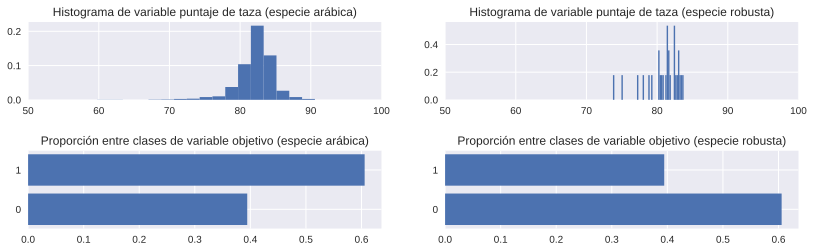

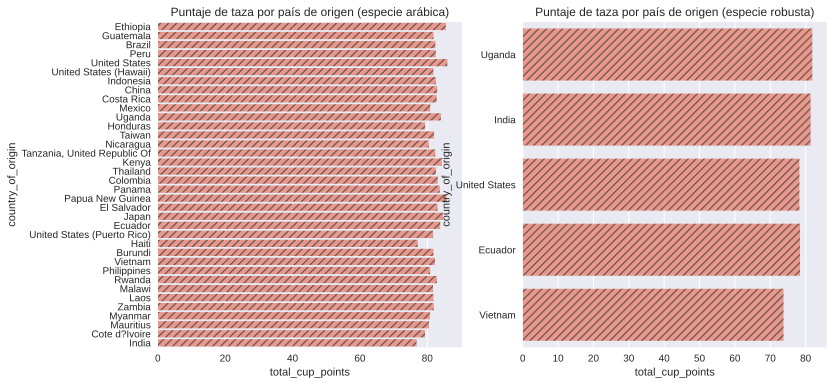

Gráfico de parcela para visualización de correlación entre variables seleccionadas.


In [14]:
#análisis de datos

#se crea la columna objetivo "coe_winner" con valores binarios según corresponda: "no clasificado" (total_cup_points) <= 82 > (total_cup_points) "clasificado"
df4a['coe_winner'] = df4a['total_cup_points'].apply(lambda x: 1 if x > 82 else 0) #arabica
df5a['coe_winner'] = df5a['total_cup_points'].apply(lambda x: 1 if x > 82 else 0) #robusta

print('Momentos estadísticos de la variable "puntaje de taza" (total_cup_points) para cada especie.')
print('Arabica', df4a['total_cup_points'].describe(), 'Robusta', df5a['total_cup_points'].describe(), '\n', sep='\n')

print('Visualización de la relación entre las clases de la columna objetivo.')
fig, ax = plt.subplots(2, 2, figsize=(12,4))
fig.tight_layout(pad=3.0)
ax[0,0].set_xlim(xmin=50, xmax=100)
ax[0,1].set_xlim(xmin=50, xmax=100)
ax[0,0].hist(df4a['total_cup_points'], bins=50, density=True)
ax[0,1].hist(df5a['total_cup_points'], bins=50, density=True)
ax[1,0].barh(df4a['coe_winner'].value_counts(normalize=True).index, df4a['coe_winner'].value_counts(normalize=True).values)
ax[1,1].barh(df5a['coe_winner'].value_counts(normalize=True).index, df4a['coe_winner'].value_counts(normalize=True).values)
ax[0,0].set(title='Histograma de variable puntaje de taza (especie arábica)')
ax[0,1].set(title='Histograma de variable puntaje de taza (especie robusta)')
ax[1,0].set(title='Proporción entre clases de variable objetivo (especie arábica)')
ax[1,1].set(title='Proporción entre clases de variable objetivo (especie robusta)')
plt.show()

fig, ax = plt.subplots(1, 2, figsize=(12,6))
sns.barplot(x='total_cup_points', y='country_of_origin', data=df4a, ax=ax[0],color='tomato', hatch='///', alpha=0.7, ci=None)
sns.barplot(x='total_cup_points', y='country_of_origin', data=df5a, ax=ax[1],color='tomato', hatch='///', alpha=0.7, ci=None)
ax[0].set(title='Puntaje de taza por país de origen (especie arábica)')
ax[1].set(title='Puntaje de taza por país de origen (especie robusta)')
plt.show()

print('Gráfico de parcela para visualización de correlación entre variables seleccionadas.')
sns.pairplot(df4a[['altitude_mean_meters','aroma','flavor','aftertaste','acidity','sweetness','body','balance','uniformity',\
                   'clean_cup','moisture','category_one_defects','quakers','category_two_defects']],\
             corner=True, diag_kind='hist', height=1.5, aspect=1)
plt.show()

  * La variable objetivo está definida de forma binaria como clasificado a taza de la excelencia cuando el total de puntos de taza es mayor a 82 y como no clasificado cuando es menor o igual a dicha calificación.
  * El gráfico de proporción para la variable objetivo permite observar un desbalanceo de clases con una relación de aprox. 60/40. Se puede considerar la opción de aplicar una técnica de sobremuestreo aleatorio de las observaciones minoritarias, sin embargo se debe considerar que este procedimiento puede reducir la varianza del conjunto de datos al realizar una duplicación de las observaciones muestreadas.
  * El gráfico de correlación permite observar que algunas variables numéricas tienen una relación directamente proporcional, por lo que podrían considerarse dentro del método de reducción de dimensionalidad. Mientras que otras sí parecen aportar una variabilidad significativa al conjunto.
  * La diagonal del gráfico de correlación permite observar el histograma correspondiente a cada variable, las cuales en algunos casos siguen una distribución normal en apariencia, mientas que otras agrupan la gran mayoría de observaciones en un rango específico. Ejemplo de esto son las columnas de cantidad de defectos categoría I, quakers, uniformidad y taza limpia, las cuales son características que difícilmente pueden presentarse en una competición de taza de la excelencia.

---

In [15]:
%%capture
#visualización de datos a través de la librería pandas_profiling

from pandas_profiling import ProfileReport
from pandas_profiling.utils.cache import cache_file

df4aprof = ProfileReport(df4a, title="Arabica", html={"style": {"full_width": True}}, sort=None)
df5aprof = ProfileReport(df5a, title="Robusta", html={"style": {"full_width": True}}, sort=None)
df6aprof = ProfileReport(df6a, title="Climate", html={"style": {"full_width": True}}, sort=None)

df4aprof.to_file("/content/Arabica.html")
df5aprof.to_file("/content/Robusta.html")
df6aprof.to_file("/content/Climate.html")

### Conclusiones

Según el análisis realizado se puede concluir lo siguiente:

  * Se determina que el conjunto de datos Arabica aporta variables muy aptas para un modelo de clasificación considerando sus variables numéricas principalmente (calificaciones de características del grano y organolépticas).

  * El conjunto Robusta, debido a su tamaño y proporción de valores nulos, es un conjunto que podría ser descartado.

  * Los datos anexos a este cuaderno y generados mediante la librería Pandas Profiling, permiten realizar un análisis de variables mucho más exhaustivo para cada uno de los conjuntos de datos.

---

##### Código para generar PDF


In [16]:
# !wget -nc https://raw.githubusercontent.com/brpy/colab-pdf/master/colab_pdf.py
# from colab_pdf import colab_pdf
# colab_pdf('BIGDATA_07_2021_ProyectoFinal-1_ESV.ipynb')